# 01__calculate_enrichments

in this notebook, i filter sgRNAs and calculate transcript-level enrichment scores. (briefly: sgRNA-level enrichments are calculated by dividing their frequency in the undifferentiated population by their frequency in the differentiated population, and then the scores of the top 3 sgRNAs are averaged to get transcript-level enrichments).

figures in this notebook:
- Fig 3C (scatter plot showing sgRNA frequencies in Endo-- replicates)
- Fig 3D (boxplot comparing positive control sgRNA enrichments to negative control sgRNA enrichments)
- Fig 3E (scatter plot showing sgRNA enrichments across replicates after filtering)
- Fig S5A (density plots showing sgRNA counts in each sample)
- Fig S5C (plots showing control rankings after setting Day Zero filter at various thresholds)

In [1]:
import warnings
warnings.filterwarnings('ignore')

import math
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
import scipy.stats as stats
import seaborn as sns
import sys
import time

from ast import literal_eval
from scipy.stats import spearmanr
from scipy.stats import pearsonr
from statsmodels.sandbox.stats import multicomp

# import utils
sys.path.append("../../../utils")
from plotting_utils import *
from enrich_utils import *

%matplotlib inline
%config InlineBackend.figure_format = 'svg'
mpl.rcParams['figure.autolayout'] = False

In [2]:
sns.set(**PAPER_PRESET)
fontsize = PAPER_FONTSIZE

## functions

In [3]:
def get_gene_enrichments(df, thresh, min_sgRNAs_represented, top_sgRNAs_to_rank, n_sgRNAs_for_std, rank_col, enrich_col):
    
    # get col prefix
    prefix = rank_col.split("_")[0]
    rep = rank_col.split("__")[1]
    
    filt_df = df[df["Day_Zero__%s" % rep] >= thresh]
    
    
    if len(filt_df) == 0:
        return None

    # only examine genes with at least x sgRNAs represented
    df_grp = filt_df.groupby(["group_id", "ctrl_status", "gene_name", "transcript_name",
                              "endo_ctrl_val"])["sgRNA"].agg("count").reset_index()
    good_groups = df_grp[df_grp["sgRNA"] >= min_sgRNAs_represented]["group_id"]
    filt_df = filt_df[filt_df["group_id"].isin(good_groups)]

    # now take the top x sgRNAs per group_id
    enrich_sort = filt_df.sort_values(by=["group_id", enrich_col], ascending=False)[["group_id", 
                                                                                     "ctrl_status",
                                                                                     "endo_ctrl_val",
                                                                                     "gene_name",
                                                                                     "transcript_name",
                                                                                     enrich_col,
                                                                                     rank_col]]

    enrich_top = enrich_sort.groupby(["group_id", "ctrl_status", "endo_ctrl_val",
                                      "gene_name", "transcript_name"]).head(top_sgRNAs_to_rank)
    
    enrich_grp_med = enrich_top.groupby(["group_id", 
                                         "ctrl_status",
                                         "endo_ctrl_val",
                                         "gene_name", 
                                         "transcript_name"])[enrich_col].agg("median").reset_index()
    
    enrich_for_std = enrich_sort.groupby(["group_id", "ctrl_status", "endo_ctrl_val",
                                          "gene_name", "transcript_name"]).head(n_sgRNAs_for_std)
    enrich_grp_std = enrich_for_std.groupby(["group_id", 
                                             "ctrl_status", 
                                             "endo_ctrl_val",
                                             "gene_name", 
                                             "transcript_name"])[enrich_col].agg("std").reset_index()
    enrich_grp_std[enrich_col].replace(0, 1, inplace=True)
    enrich_grp = enrich_grp_med.merge(enrich_grp_std, on=["group_id", 
                                                          "ctrl_status", 
                                                          "endo_ctrl_val",
                                                          "gene_name", 
                                                          "transcript_name"],
                                      suffixes=("_med", "_std"))

    
    weighted_score_col = "%s_score__%s" % (prefix, rep)
    #enrich_grp[weighted_score_col] = enrich_grp["%s_med" % enrich_col] * (1-enrich_grp["%s_std" % enrich_col])
    enrich_grp[weighted_score_col] = enrich_grp["%s_med" % enrich_col]
    enrich_grp["%s_score_rank__%s" % (prefix, rep)] = enrich_grp[weighted_score_col].rank(ascending=False)
    
        
    return enrich_grp

## variables

In [4]:
index_f = "../../../data/01__design/02__final_sgRNAs/crispri_with_primers.txt"

In [5]:
endo_ctrls_validated_f = "../../../misc/04__pos_ctrls/endo_ctrls_validated.updated.txt"

In [6]:
data_f = "../../../data/02__screen/01__normalized_counts/normalized_sgRNA_counts.txt"

In [7]:
min_sgRNAs_represented = 3
top_sgRNAs_to_rank = 3
n_sgRNAs_for_std = 3

## 1. load data

In [8]:
index = pd.read_table(index_f, sep="\t")
index.head()

,sgRNA,count,tss_id_hg38,transcript_id,transcript_name,gene_id,gene_name,tss_type,cage_id_hg19,sgRNA_qual,cut_offset,rank,sgRNA_id,ctrl_status,oligo,oligo_len
0,TTGCAAGTGTCTTTAAACTA,1,NC_000001.11:-:100084320,ENST00000432294.1_1,RP4-714D9.2-001,ENSG00000241073.1_2,RP4-714D9.2,FANTOM CAT assignment,"chr1:100549872..100549883,-",good,225.0,1.0,sgRNA:104025__gene:RP4-714D9.2,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGTTGCAAGTGTCTTTAA...,85
1,ATTGCAAGTGTCTTTAAACT,1,NC_000001.11:-:100084320,ENST00000432294.1_1,RP4-714D9.2-001,ENSG00000241073.1_2,RP4-714D9.2,FANTOM CAT assignment,"chr1:100549872..100549883,-",good,224.0,2.0,sgRNA:027184__gene:RP4-714D9.2,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGATTGCAAGTGTCTTTA...,85
2,AGCCAGTATCTTGAAACTAT,1,NC_000001.11:-:100084320,ENST00000432294.1_1,RP4-714D9.2-001,ENSG00000241073.1_2,RP4-714D9.2,FANTOM CAT assignment,"chr1:100549872..100549883,-",good,199.0,3.0,sgRNA:017196__gene:RP4-714D9.2,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGAGCCAGTATCTTGAAA...,85
3,TGCCAATAGTTTCAAGATAC,1,NC_000001.11:-:100084320,ENST00000432294.1_1,RP4-714D9.2-001,ENSG00000241073.1_2,RP4-714D9.2,FANTOM CAT assignment,"chr1:100549872..100549883,-",good,190.0,4.0,sgRNA:095459__gene:RP4-714D9.2,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGTGCCAATAGTTTCAAG...,85
4,ACAGTAGTGTATCTAAATGG,1,NC_000001.11:-:100084320,ENST00000432294.1_1,RP4-714D9.2-001,ENSG00000241073.1_2,RP4-714D9.2,FANTOM CAT assignment,"chr1:100549872..100549883,-",good,290.0,5.0,sgRNA:009695__gene:RP4-714D9.2,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGACAGTAGTGTATCTAA...,85


In [9]:
endo_ctrls_validated = pd.read_table(endo_ctrls_validated_f, sep="\t", header=None)
endo_ctrls_validated.columns = ["gene_name"]
endo_ctrls_validated.head()

,gene_name
0,ACVR1B
1,BMP2
2,CDH2
3,CER1
4,DUSP4


In [10]:
data = pd.read_table(data_f, sep="\t")
data_cols = [x for x in data.columns if "BFP+" in x or "Day_Zero" in x or x == "sgRNA"]
data_cols = [x for x in data_cols if "enrichment" not in x]
data = data[data_cols]
data.head()

,sgRNA,Day_Zero__rep1,Day_Zero__rep2,BFP+_Endo++__rep1,BFP+_Endo++__rep2,BFP+_Endo--__rep1,BFP+_Endo--__rep2
0,AGGAGGGCCCGCCGGAGGAG,0.618288,0.466037,0.004668,0.010147,15.064555,1.312613
1,GGACCCACCGGGCGGAGGAG,0.772861,0.146071,0.009335,0.010147,24.010203,1.738326
2,AAGAACCCTCCACCACACCC,3.326981,3.686559,0.004668,0.730608,12.662165,0.007095
3,CAGGCCAAGGGAGTAGAAGG,2.679250,0.403435,0.004668,0.010147,11.471237,0.007095
4,GCAATTGAAAAAGGGCAGAA,9.679159,9.918929,0.004668,0.375451,11.156394,18.844870


## 2. add control ID information to index

In [11]:
len(index.transcript_id.unique())

10898

In [12]:
# fix index ID columns that can have duplicates in them due to previous aggregation
index["gene_id"] = index.apply(fix_id_dupes, column="gene_id", axis=1)
index["gene_name"] = index.apply(fix_id_dupes, column="gene_name", axis=1)
index["transcript_id"] = index.apply(fix_id_dupes, column="transcript_id", axis=1)
index["transcript_name"] = index.apply(fix_id_dupes, column="transcript_name", axis=1)
index = index.drop_duplicates()
len(index.transcript_id.unique())

10851

In [13]:
# get control IDs
index["scramble_id"] = index.apply(get_scramble_id, axis=1)
index["group_id"] = index.apply(get_group_id, axis=1)
index["endo_ctrl_val"] = index["gene_name"].isin(endo_ctrls_validated["gene_name"])
index.endo_ctrl_val.value_counts()

False    111561
True        240
Name: endo_ctrl_val, dtype: int64

In [14]:
index["ctrl_status_fixed"] = index.apply(fix_ctrl_status_w_DE_mRNAs, axis=1)

In [15]:
index.groupby("ctrl_status")["sgRNA"].agg("count")

ctrl_status
control           2844
experimental    103957
scramble          5000
Name: sgRNA, dtype: int64

In [16]:
index.groupby("ctrl_status_fixed")["sgRNA"].agg("count")

ctrl_status_fixed
control            240
experimental    103957
mRNA              2604
scramble          5000
Name: sgRNA, dtype: int64

In [17]:
index[["tss_id_hg38", "ctrl_status_fixed"]].drop_duplicates().groupby("ctrl_status_fixed")["tss_id_hg38"].agg("count")

ctrl_status_fixed
control            24
experimental    10567
mRNA              261
scramble            1
Name: tss_id_hg38, dtype: int64

## 3. merge sgRNA counts w/ index

In [18]:
data = data.merge(index, on="sgRNA")
data.sample(5)

,sgRNA,Day_Zero__rep1,Day_Zero__rep2,BFP+_Endo++__rep1,BFP+_Endo++__rep2,BFP+_Endo--__rep1,BFP+_Endo--__rep2,count,tss_id_hg38,transcript_id,...,cut_offset,rank,sgRNA_id,ctrl_status,oligo,oligo_len,scramble_id,group_id,endo_ctrl_val,ctrl_status_fixed
99152,GGTGGCCACTCTGCTAACGT,8.913659,6.677540,9.914278,8.665822,0.006844,2.845178,1,NC_000002.12:-:170695369,ENST00000428156.1_1,...,55.0,1.0,sgRNA:077255__gene:AC007277.3,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGGGTGGCCACTCTGCTA...,85,none,NC_000002.12:-:170695369,False,experimental
71159,CAAAACTGATTCCATTAAAC,9.487784,9.459849,16.313748,9.690702,17.809164,1.993753,1,NC_000005.10:-:26399818,ENST00000512939.1_1,...,0.0,9.0,sgRNA:027883__gene:RP11-351N6.1,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGCAAAACTGATTCCATT...,85,none,NC_000005.10:-:26399818,False,experimental
71198,CAAGGTTTGAAGTCTTCCCG,9.973582,14.711456,13.195699,9.528345,3.456429,9.855243,1,NC_000020.11:+:32116171,ENST00000611964.1_1,...,170.0,10.0,sgRNA:029122__gene:RP5-836N17.4,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGCAAGGTTTGAAGTCTT...,85,none,NC_000020.11:+:32116171,False,experimental
62298,ATCTTTCAAGGAGACCAAGT,0.044163,0.006956,0.004668,0.081179,0.006844,0.007095,1,NC_000013.11:-:75935131,ENST00000565815.1_1,...,9.0,7.0,sgRNA:024970__gene:LINC00561,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGATCTTTCAAGGAGACC...,85,none,NC_000013.11:-:75935131,False,experimental
3611,ACAAGGGTATGAATACCTGG,10.039827,10.315408,3.836882,8.625232,22.675543,5.810975,1,NC_000014.9:+:73789079,ENST00000553470.1_1,...,37.0,4.0,sgRNA:008614__gene:RP5-1021I20.1,experimental,TCACAACTACACCAGAAGCCACCTTGTTGGACAAGGGTATGAATAC...,85,none,NC_000014.9:+:73789079,False,experimental


In [19]:
data.columns

Index(['sgRNA', 'Day_Zero__rep1', 'Day_Zero__rep2', 'BFP+_Endo++__rep1',
       'BFP+_Endo++__rep2', 'BFP+_Endo--__rep1', 'BFP+_Endo--__rep2', 'count',
       'tss_id_hg38', 'transcript_id', 'transcript_name', 'gene_id',
       'gene_name', 'tss_type', 'cage_id_hg19', 'sgRNA_qual', 'cut_offset',
       'rank', 'sgRNA_id', 'ctrl_status', 'oligo', 'oligo_len', 'scramble_id',
       'group_id', 'endo_ctrl_val', 'ctrl_status_fixed'],
      dtype='object')

## 3. calculate enrichments of endo-- over endo++ per sgRNA

In [20]:
data["BFP+_enrichment__rep1"] = (data["BFP+_Endo--__rep1"])/(data["BFP+_Endo++__rep1"])
data["BFP+_log_enrichment__rep1"] = np.log2(data["BFP+_enrichment__rep1"])

data["BFP+_enrichment__rep2"] = (data["BFP+_Endo--__rep2"])/(data["BFP+_Endo++__rep2"])
data["BFP+_log_enrichment__rep2"] = np.log2(data["BFP+_enrichment__rep2"])

data["BFP+_enrichment__mean"] = data[["BFP+_enrichment__rep1", "BFP+_enrichment__rep2"]].mean(axis=1)
data["BFP+_log_enrichment__mean"] = np.log2(data["BFP+_enrichment__mean"])

data.sort_values(by="BFP+_log_enrichment__mean", ascending=False).head()

,sgRNA,Day_Zero__rep1,Day_Zero__rep2,BFP+_Endo++__rep1,BFP+_Endo++__rep2,BFP+_Endo--__rep1,BFP+_Endo--__rep2,count,tss_id_hg38,transcript_id,...,scramble_id,group_id,endo_ctrl_val,ctrl_status_fixed,BFP+_enrichment__rep1,BFP+_log_enrichment__rep1,BFP+_enrichment__rep2,BFP+_log_enrichment__rep2,BFP+_enrichment__mean,BFP+_log_enrichment__mean
0,AGGAGGGCCCGCCGGAGGAG,0.618288,0.466037,0.004668,0.010147,15.064555,1.312613,2,NC_000015.10:+:89378103,"['ENST00000560596.5_1', 'ENST00000559235.5_1']",...,none,NC_000015.10:+:89378103,False,experimental,3227.377149,11.656146,129.355511,7.015198,1678.366330,10.712842
1,GGACCCACCGGGCGGAGGAG,0.772861,0.146071,0.009335,0.010147,24.010203,1.738326,1,NC_000023.11:-:24149637,ENST00000427551.1_1,...,none,NC_000023.11:-:24149637,False,experimental,2571.930722,11.328636,171.308650,7.420454,1371.619686,10.421665
2,AAGAACCCTCCACCACACCC,3.326981,3.686559,0.004668,0.730608,12.662165,0.007095,2,NC_000009.12:+:62801486,"['ENST00000427509.5_1', 'ENST00000424345.5_1']",...,none,NC_000009.12:+:62801486,False,experimental,2712.697740,11.405513,0.009711,-6.686109,1356.353726,10.405518
3,CAGGCCAAGGGAGTAGAAGG,2.679250,0.403435,0.004668,0.010147,11.471237,0.007095,1,NC_000006.12:+:131902940,ENST00000419695.1_1,...,none,NC_000006.12:+:131902940,False,experimental,2457.557520,11.263009,0.699219,-0.516184,1229.128370,10.263420
4,GCAATTGAAAAAGGGCAGAA,9.679159,9.918929,0.004668,0.375451,11.156394,18.844870,1,NC_000003.12:-:27722707,ENST00000461503.2_1,...,none,NC_000003.12:-:27722707,True,control,2390.106657,11.222859,50.192584,5.649402,1220.149621,10.252842


## 4. plot distributions of counts in each population

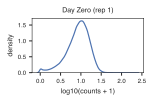

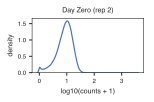

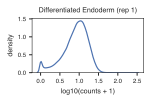

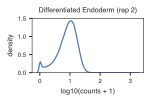

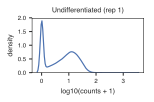

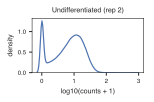

In [21]:
cols = ["Day_Zero__rep1", "Day_Zero__rep2", "BFP+_Endo++__rep1", "BFP+_Endo++__rep2", 
        "BFP+_Endo--__rep1", "BFP+_Endo--__rep2"]
names = ["Day Zero (rep 1)", "Day Zero (rep 2)", "Differentiated Endoderm (rep 1)", "Differentiated Endoderm (rep 2)",
         "Undifferentiated (rep 1)", "Undifferentiated (rep 2)"]

c = 1
for col, name in zip(cols, names):
    
    fig = plt.figure(figsize=(2, 1))
    ax = sns.distplot(np.log10(data[col]+1), hist=False)
    ax.set_ylabel("density")
    ax.set_xlabel("log10(counts + 1)")
    ax.set_title(name)
    plt.show()
    fig.savefig("FigS5A_%s.pdf" % c, figure="dpi", bbox_inches="tight")
    plt.close()
    c += 1

## 5. investigate where main controls (FOXA2, SOX17, GATA6) rank based on day 0 cut-offs

In [22]:
data["BFP+_rank__rep1"] = data["BFP+_log_enrichment__rep1"].rank(ascending=False)
data["BFP+_rank__rep2"] = data["BFP+_log_enrichment__rep2"].rank(ascending=False)
data["BFP+_rank__mean"] = data["BFP+_log_enrichment__mean"].rank(ascending=False)

In [23]:
filt_threshs = list(np.linspace(2, 10, 17))
filt_threshs

[2.0,
 2.5,
 3.0,
 3.5,
 4.0,
 4.5,
 5.0,
 5.5,
 6.0,
 6.5,
 7.0,
 7.5,
 8.0,
 8.5,
 9.0,
 9.5,
 10.0]

In [24]:
ctrls = ["FOXA2", "SOX17", "GATA6"]
all_ctrl_ranks = {}

enrich_cols = ["BFP+_log_enrichment__rep1", "BFP+_log_enrichment__rep2"]

rank_cols = ["BFP+_rank__rep1", "BFP+_rank__rep2"]

for enrich_col, rank_col in zip(enrich_cols, rank_cols):
    prefix = enrich_col.split("_")[0]
    rep = enrich_col.split("__")[1]
    out_col = "%s_score_rank__%s" % (prefix, rep)
    ctrl_ranks = {}
    for ctrl in ctrls:
        ranks_per_ctrl = {}
        for thresh in filt_threshs:
            all_enrich_grp = get_gene_enrichments(data, thresh, min_sgRNAs_represented, 
                                                  top_sgRNAs_to_rank, n_sgRNAs_for_std, rank_col, enrich_col)
            if len(all_enrich_grp) > 0:
                ctrl_df = all_enrich_grp[all_enrich_grp["gene_name"] == ctrl]
                if len(ctrl_df) > 0:
                    ctrl_rank = ctrl_df[out_col].iloc[0]
                else:
                    ctrl_rank = np.nan
            else:
                ctrl_rank = np.nan
            ranks_per_ctrl[thresh] = {"rank": ctrl_rank}
        ctrl_ranks[ctrl] = ranks_per_ctrl
    all_ctrl_ranks["%s_%s" % (prefix, rep)] = ctrl_ranks

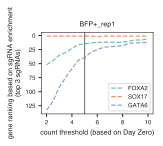

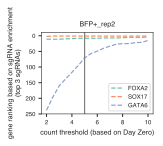

In [25]:
score_cols = ["BFP+_rep1", "BFP+_rep2"]

c = 1
for score_col in score_cols:
    FOXA2_ranks = pd.DataFrame.from_dict(all_ctrl_ranks[score_col]["FOXA2"]).T.reset_index()
    SOX17_ranks = pd.DataFrame.from_dict(all_ctrl_ranks[score_col]["SOX17"]).T.reset_index()
    GATA6_ranks = pd.DataFrame.from_dict(all_ctrl_ranks[score_col]["GATA6"]).T.reset_index()
    
    # plot
    fig = plt.figure(figsize=(2,1.5))
    plt.plot(FOXA2_ranks["index"], FOXA2_ranks["rank"], '--', color=sns.color_palette("Set2")[0], label="FOXA2")
    plt.plot(SOX17_ranks["index"], SOX17_ranks["rank"], '--', color=sns.color_palette("Set2")[1], label="SOX17")
    plt.plot(GATA6_ranks["index"], GATA6_ranks["rank"], '--', color=sns.color_palette("Set2")[2], label="GATA6")
    plt.ylabel("gene ranking based on sgRNA enrichment\n(top %s sgRNAs)" % top_sgRNAs_to_rank)
    plt.xlabel("count threshold (based on Day Zero)")
    plt.title(score_col)
    plt.axvline(x=5, color="gray")
    plt.gca().invert_yaxis()
    plt.legend()
    plt.show()
    fig.savefig("FigS5C_%s.pdf" % c, dpi="figure", bbox_inches="tight")
    plt.close()
    c += 1

## 6. filter sgRNAs based on Day Zero counts outlined above

In [26]:
cpm_thresh = 5

In [27]:
all_enrich_grp_1 = get_gene_enrichments(data, cpm_thresh, min_sgRNAs_represented, 
                                      top_sgRNAs_to_rank, n_sgRNAs_for_std, "BFP+_rank__rep1", 
                                      "BFP+_enrichment__rep1")

all_enrich_grp_2 = get_gene_enrichments(data, cpm_thresh, min_sgRNAs_represented, 
                                      top_sgRNAs_to_rank, n_sgRNAs_for_std, "BFP+_rank__rep2", 
                                      "BFP+_enrichment__rep2")

all_enrich_grp = all_enrich_grp_1.merge(all_enrich_grp_2, on=["group_id", "ctrl_status",
                                                              "endo_ctrl_val", "gene_name", "transcript_name"])
all_enrich_grp.sample(5)

,group_id,ctrl_status,endo_ctrl_val,gene_name,transcript_name,BFP+_enrichment__rep1_med,BFP+_enrichment__rep1_std,BFP+_score__rep1,BFP+_score_rank__rep1,BFP+_enrichment__rep2_med,BFP+_enrichment__rep2_std,BFP+_score__rep2,BFP+_score_rank__rep2
3066,NC_000005.10:-:141096351,experimental,False,CTC-270D5.1,CTC-270D5.1-005,0.868958,0.989629,0.868958,9860.0,1.130226,0.520409,1.130226,8566.0
10807,sgRNA:059480,scramble,False,scramble,scramble,2.650196,1.648697,2.650196,1451.0,0.192403,2.022388,0.192403,11036.0
4298,NC_000008.11:+:38148741,experimental,False,RP11-90P5.2,RP11-90P5.2-001,0.821475,0.064429,0.821475,10021.0,1.018984,0.443282,1.018984,9284.0
10990,sgRNA:100424,scramble,False,scramble,scramble,0.661017,0.304241,0.661017,10451.0,1.878237,0.330314,1.878237,2684.0
3527,NC_000006.12:-:137861244,experimental,False,RP11-356I2.4,RP11-356I2.4-002,1.449898,0.500524,1.449898,6780.0,1.433399,0.479342,1.433399,6007.0


In [28]:
all_enrich_grp["BFP+_score__mean"] = all_enrich_grp[["BFP+_score__rep1", "BFP+_score__rep2"]].mean(axis=1)
all_enrich_grp["BFP+_score_rank__mean"] = all_enrich_grp["BFP+_score__mean"].rank(ascending=False)
all_enrich_grp.sort_values(by="BFP+_score_rank__mean").head()

,group_id,ctrl_status,endo_ctrl_val,gene_name,transcript_name,BFP+_enrichment__rep1_med,BFP+_enrichment__rep1_std,BFP+_score__rep1,BFP+_score_rank__rep1,BFP+_enrichment__rep2_med,BFP+_enrichment__rep2_std,BFP+_score__rep2,BFP+_score_rank__rep2,BFP+_score__mean,BFP+_score_rank__mean
4310,NC_000008.11:+:54457934,control,True,SOX17,SOX17-001,232.279434,65.085690,232.279434,1.0,313.295214,66.580333,313.295214,1.0,272.787324,1.0
2199,NC_000003.12:-:27722707,control,True,EOMES,EOMES-004,156.570722,1321.309997,156.570722,2.0,22.862835,21.757059,22.862835,5.0,89.716778,2.0
2198,NC_000003.12:-:27722322,control,True,EOMES,EOMES-001,43.594914,298.176445,43.594914,3.0,112.574256,41.078498,112.574256,2.0,78.084585,3.0
7628,NC_000016.10:+:23452748,experimental,False,CTD-2270L9.4,"['CTD-2270L9.4-002', 'CTD-2270L9.4-001', 'CTD-...",3.702626,2.842325,3.702626,312.0,62.143087,25.179505,62.143087,3.0,32.922856,4.0
10394,NC_000023.11:-:11111137,experimental,False,RP11-120D5.1,"['RP11-120D5.1-004', 'RP11-120D5.1-005']",21.636555,2.965312,21.636555,6.0,15.060327,3.112489,15.060327,7.0,18.348441,5.0


## 7. plot enrichment of scrambled genes vs. controls

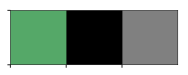

In [29]:
pal = {"control": sns.color_palette()[2], "experimental": "black", "scramble": "gray"}
sns.palplot(pal.values())

In [30]:
data["ctrl_status_fixed"] = data.apply(fix_ctrl_status, axis=1)
all_enrich_grp["ctrl_status_fixed"] = all_enrich_grp.apply(fix_ctrl_status, axis=1)

In [31]:
print(len(data))
print(len(all_enrich_grp))

111801
11014


In [32]:
data_filt = data[(data["Day_Zero__rep1"] >= cpm_thresh) | (data["Day_Zero__rep2"] >= cpm_thresh)]
print(len(data_filt))
data_filt_top = data_filt.sort_values(by="BFP+_log_enrichment__mean", ascending=False).head(round(len(data_filt)/4))

88718


In [33]:
tmp = data_filt[data_filt["ctrl_status_fixed"].isin(["scramble", "control"])][["sgRNA", "ctrl_status_fixed",
                                                                               "BFP+_enrichment__rep1",
                                                                               "BFP+_enrichment__rep2"]]
tmp = pd.melt(tmp, id_vars=["sgRNA", "ctrl_status_fixed"])
tmp.head()

,sgRNA,ctrl_status_fixed,variable,value
0,GCAATTGAAAAAGGGCAGAA,control,BFP+_enrichment__rep1,2390.106657
1,TTTGCAAAGCATGCAGTTAG,control,BFP+_enrichment__rep1,558.815734
2,GTCTGGTCTACAGCGTACCC,control,BFP+_enrichment__rep1,147.131683
3,GACCGCGACAGGCCAGAACA,control,BFP+_enrichment__rep1,108.719851
4,ACCGCGACAGGCCAGAACAC,control,BFP+_enrichment__rep1,274.974758


0.000138681641465
1.04687725226e-05


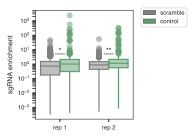

In [34]:
hue_order = ["scramble", "control"]
order = ["BFP+_enrichment__rep1", "BFP+_enrichment__rep2"]
fig = plt.figure(figsize=(1.75, 2))
ax = sns.boxplot(data=tmp, x="variable", hue="ctrl_status_fixed", y="value", 
                 flierprops = dict(marker='o', markersize=5), order=order, hue_order=hue_order, palette=pal)
mimic_r_boxplot(ax)
ax.set_yscale("log")
ax.set_ylabel("")
ax.set_ylabel("sgRNA enrichment")
ax.set_xticklabels(["rep 1", "rep 2"])
ax.set_xlabel("")

# calc p-vals b/w dists
rep1 = tmp[tmp["variable"] == "BFP+_enrichment__rep1"]
rep1_dist1 = np.asarray(rep1[rep1["ctrl_status_fixed"] == "scramble"]["value"])
rep1_dist2 = np.asarray(rep1[rep1["ctrl_status_fixed"] == "control"]["value"])

rep1_dist1 = rep1_dist1[~np.isnan(rep1_dist1)]
rep1_dist2 = rep1_dist2[~np.isnan(rep1_dist2)]

u, pval = stats.mannwhitneyu(rep1_dist1, rep1_dist2, alternative="less", use_continuity=False)
print(pval)
annotate_pval(ax, -0.1, 0.1, 5, 0, 4.8, pval, fontsize)

rep2 = tmp[tmp["variable"] == "BFP+_enrichment__rep2"]
rep2_dist1 = np.asarray(rep2[rep2["ctrl_status_fixed"] == "scramble"]["value"])
rep2_dist2 = np.asarray(rep2[rep2["ctrl_status_fixed"] == "control"]["value"])

rep2_dist1 = rep2_dist1[~np.isnan(rep2_dist1)]
rep2_dist2 = rep2_dist2[~np.isnan(rep2_dist2)]

u, pval = stats.mannwhitneyu(rep2_dist1, rep2_dist2, alternative="less", use_continuity=False)
print(pval)
annotate_pval(ax, 0.9, 1.1, 5, 0, 4.8, pval, fontsize)
        
        
plt.legend(loc=2, bbox_to_anchor=(1.05, 1.05))
plt.show()
fig.savefig("Fig3D.pdf", dpi="figure", bbox_inches="tight")
plt.close()

## 8. check correlations of scores across reps

In [35]:
print(len(data[(data["Day_Zero__rep1"] < cpm_thresh) & (data["Day_Zero__rep2"] < cpm_thresh)]))
print(len(data[(data["Day_Zero__rep1"] < cpm_thresh) & (data["Day_Zero__rep2"] >= cpm_thresh)]))
print(len(data[(data["Day_Zero__rep1"] >= cpm_thresh) & (data["Day_Zero__rep2"] < cpm_thresh)]))
print(len(data[(data["Day_Zero__rep1"] >= cpm_thresh) & (data["Day_Zero__rep2"] >= cpm_thresh)]))

23083
5487
7140
76091


In [36]:
print(len(data[(data["BFP+_Endo--__rep1"] < 1) & (data["BFP+_Endo--__rep2"] < 1)]))
print(len(data[(data["BFP+_Endo--__rep1"] < 1) & (data["BFP+_Endo--__rep2"] >= 1)]))
print(len(data[(data["BFP+_Endo--__rep1"] >= 1) & (data["BFP+_Endo--__rep2"] < 1)]))
print(len(data[(data["BFP+_Endo--__rep1"] >= 1) & (data["BFP+_Endo--__rep2"] >= 1)]))

13340
21774
10085
66602


In [37]:
fig = plt.figure(figsize=(2, 2))

no_nan = data[(~pd.isnull(data["BFP+_Endo--__rep1"])) & (~pd.isnull(data["BFP+_Endo--__rep2"]))]
no_nan["BFP+_Endo--__rep1_log"] = np.log10(no_nan["BFP+_Endo--__rep1"]+1)
no_nan["BFP+_Endo--__rep2_log"] = np.log10(no_nan["BFP+_Endo--__rep2"]+1)
g = sns.jointplot(data=no_nan, x="BFP+_Endo--__rep1_log", y="BFP+_Endo--__rep2_log", color="slategray", 
                   joint_kws={"rasterized": False, "s": 10, "alpha": 0.5, "linewidths": 0.5, 
                              "edgecolors": "white"},
                   marginal_kws={"bins": 15, "hist": False, "kde": True}, size=2, space=0.5)

g.set_axis_labels("log10(undifferentiated cpm + 1)\nreplicate 1", "log10(undifferentiated cpm + 1)\nreplicate 2")
g.ax_joint.axhline(y=np.log10(2), color="black", linestyle="dashed")
g.ax_joint.axvline(x=np.log10(2), color="black", linestyle="dashed")
g.ax_joint.set_xlim((-0.2, 3))
g.ax_joint.set_ylim((-0.2, 3))

g.ax_joint.set_xticks([0, 1, 2, 3])
g.ax_joint.set_yticks([0, 1, 2, 3])

plt.show()
g.savefig("Fig3C.pdf", dpi="figure", bbox_inches="tight")
plt.close()

In [38]:
# stringently filter data based on endo counts and day zero counts
data_stringent_filt = data_filt[(data_filt["Day_Zero__rep1"] >= cpm_thresh) & (data_filt["Day_Zero__rep2"] >= cpm_thresh)]
print(len(data_stringent_filt))
data_stringent_filt = data_stringent_filt[(data_stringent_filt["BFP+_Endo--__rep1"] >= 1) & 
                                          (data_stringent_filt["BFP+_Endo--__rep2"] >= 1)]
len(data_stringent_filt)

76091


57384

In [39]:
# for plotting purposes, sample from those with low enrichment rates
high_enrich = data_stringent_filt[(data_stringent_filt["BFP+_log_enrichment__rep1"] >= 1) & 
                                  (data_stringent_filt["BFP+_log_enrichment__rep2"] >= 1)]
to_sample = data_stringent_filt[~data_stringent_filt["sgRNA"].isin(high_enrich["sgRNA"])]

exp_sample = to_sample[to_sample["ctrl_status_fixed"] == "experimental"].sample(4000)
scr_sample = to_sample[to_sample["ctrl_status_fixed"] == "scramble"]
ctr_sample = to_sample[to_sample["ctrl_status_fixed"] == "control"]

for_plot = high_enrich.append(exp_sample).append(scr_sample).append(ctr_sample)
len(for_plot)

8158

0.194882727379


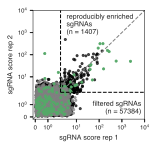

In [40]:
fig, ax = plt.subplots(figsize=(2, 2), nrows=1, ncols=1)

exp = for_plot[for_plot["ctrl_status_fixed"] == "experimental"]
scr = for_plot[for_plot["ctrl_status_fixed"] == "scramble"]
ctrl = for_plot[for_plot["ctrl_status_fixed"] == "control"]

ax.scatter(exp["BFP+_enrichment__rep1"], exp["BFP+_enrichment__rep2"], color=pal["experimental"], s=5, alpha=0.7)
ax.scatter(scr["BFP+_enrichment__rep1"], scr["BFP+_enrichment__rep2"], color=pal["scramble"], s=5, alpha=0.7)
ax.scatter(ctrl["BFP+_enrichment__rep1"], ctrl["BFP+_enrichment__rep2"], color=pal["control"], alpha=1, s=5)

ax.set_xscale('symlog', linscale=20)
ax.set_yscale('symlog', linscale=20)

ax.plot([-0.18, 10000], [-0.18, 10000], "--", color="gray", linewidth=1)
ax.plot([2, 2], [2, 10000], '--', color="black", linewidth=1)
ax.plot([2, 10000], [2, 2], '--', color="black", linewidth=1)

ax.set_xlim((-0.18, 10000))
ax.set_ylim((-0.18, 10000))

# annotate corr
no_nan = data_stringent_filt[(~pd.isnull(data_stringent_filt["BFP+_enrichment__rep1"])) & 
                             (~pd.isnull(data_stringent_filt["BFP+_enrichment__rep2"]))]
r, p = pearsonr(no_nan["BFP+_enrichment__rep1"], no_nan["BFP+_enrichment__rep2"])
print(r)
# ax.text(0.95, 0.2, "r = {:.2f}".format(r), ha="right", va="top", fontsize=fontsize, fontweight="bold",
#         transform=ax.transAxes)

# filter data to those that are reproducibly enriched in both reps
filt = data_stringent_filt[(data_stringent_filt["BFP+_enrichment__rep1"] >= 2) & 
                           (data_stringent_filt["BFP+_enrichment__rep2"] >= 2)]

ax.text(0.97, 0.17, "filtered sgRNAs\n(n = %s)" % (len(no_nan)), ha="right", va="top", fontsize=fontsize,
        transform=ax.transAxes)
ax.text(0.3, 0.97, "reproducibly enriched\nsgRNAs\n(n = %s)" % (len(filt)), ha="left", va="top", fontsize=fontsize,
        transform=ax.transAxes)

plt.xlabel("sgRNA score rep 1")
plt.ylabel("sgRNA score rep 2")
plt.show()
fig.savefig("Fig3E.pdf", dpi="figure", bbox_inches="tight")
plt.close()

In [41]:
tmp = filt[["BFP+_enrichment__rep1", "BFP+_enrichment__rep2"]]
len(tmp)

1407

In [42]:
tmp["log1"] = np.log2(tmp["BFP+_enrichment__rep1"])
tmp["log2"] = np.log2(tmp["BFP+_enrichment__rep2"])
tmp[["log1", "log2"]].corr(method="pearson")

,log1,log2
log1,1.000000,0.698004
log2,0.698004,1.000000


In [43]:
rep_scr = filt[filt["ctrl_status_fixed"] == "scramble"]
len(rep_scr["group_id"].unique())

49

In [44]:
len(rep_scr)/len(filt)

0.037668798862828715

## 9. annotate stringently-filtered sgRNAs

In [45]:
filt.head()

,sgRNA,Day_Zero__rep1,Day_Zero__rep2,BFP+_Endo++__rep1,BFP+_Endo++__rep2,BFP+_Endo--__rep1,BFP+_Endo--__rep2,count,tss_id_hg38,transcript_id,...,ctrl_status_fixed,BFP+_enrichment__rep1,BFP+_log_enrichment__rep1,BFP+_enrichment__rep2,BFP+_log_enrichment__rep2,BFP+_enrichment__mean,BFP+_log_enrichment__mean,BFP+_rank__rep1,BFP+_rank__rep2,BFP+_rank__mean
4,GCAATTGAAAAAGGGCAGAA,9.679159,9.918929,0.004668,0.375451,11.156394,18.844870,1,NC_000003.12:-:27722707,ENST00000461503.2_1,...,control,2390.106657,11.222859,50.192584,5.649402,1220.149621,10.252842,7.0,124.0,5.0
41,TTTGCAAAGCATGCAGTTAG,8.081913,7.435719,0.046677,0.142063,26.084061,7.308063,1,NC_000003.12:-:27722322,ENST00000295743.8_1,...,control,558.815734,9.126229,51.442539,5.684890,305.129137,8.253276,31.0,122.0,42.0
47,AAGTGGAGCCCAGACAACAG,10.113433,7.289648,2.287192,0.020295,7.426189,9.848148,1,NC_000011.10:+:90223166,ENST00000623330.1_1,...,experimental,3.246858,1.699044,485.257973,8.922608,244.252416,7.932229,7260.0,13.0,48.0
54,GTCTGGTCTACAGCGTACCC,8.170240,8.979900,3.659507,0.527661,538.429494,165.871755,1,NC_000008.11:+:54457934,ENST00000297316.4_1,...,control,147.131683,7.200964,314.352718,8.296240,230.742201,7.850138,76.0,25.0,55.0
61,GACCGCGACAGGCCAGAACA,7.728606,8.952077,4.359668,0.314567,473.982494,98.552429,1,NC_000008.11:+:54457934,ENST00000297316.4_1,...,control,108.719851,6.764472,313.295214,8.291379,211.007533,7.721151,100.0,26.0,62.0


In [46]:
all_enrich_grp["stringent_filt"] = all_enrich_grp["group_id"].isin(filt["group_id"])
len(all_enrich_grp[all_enrich_grp["stringent_filt"]])

1270

## 10. write file

In [47]:
f = "../../../data/02__screen/02__enrichment_data/enrichment_values.tmp"
print(len(all_enrich_grp))
all_enrich_grp.to_csv(f, sep="\t", index=False)

11014


In [48]:
f = "../../../data/02__screen/02__enrichment_data/filtered_sgRNAs.tmp"
print(len(filt))
filt.to_csv(f, sep="\t", index=False)

1407


In [49]:
f = "../../../data/02__screen/02__enrichment_data/data_stringent_filt.tmp"
print(len(data_stringent_filt))
data_stringent_filt.to_csv(f, sep="\t", index=False)

57384
